In [0]:
import matplotlib.pyplot as plt
import seaborn as sns

import pandas as pd

from pyspark.sql.functions import col, isnan, when, count
from pyspark.sql import functions as F

from pyspark.ml.feature import StringIndexer
from pyspark.ml.feature import VectorAssembler

from pyspark.ml.classification import RandomForestClassifier

from pyspark.ml.evaluation import MulticlassClassificationEvaluator

In [0]:
# File locations and types
train_file_location = "/FileStore/tables/train.csv"
test_file_location = "/FileStore/tables/test.csv"
file_type = "csv"

infer_schema = "true"
first_row_is_header = "true"
delimiter = ","

# Read the train.csv file
train_df = spark.read.format(file_type) \
  .option("inferSchema", infer_schema) \
  .option("header", first_row_is_header) \
  .option("sep", delimiter) \
  .load(train_file_location)

# Read the test.csv file
test_df = spark.read.format(file_type) \
  .option("inferSchema", infer_schema) \
  .option("header", first_row_is_header) \
  .option("sep", delimiter) \
  .load(test_file_location)

# Concatenate the DataFrames
df = train_df.union(test_df)

display(df)

_c0,id,Gender,Customer Type,Age,Type of Travel,Class,Flight Distance,Inflight wifi service,Departure/Arrival time convenient,Ease of Online booking,Gate location,Food and drink,Online boarding,Seat comfort,Inflight entertainment,On-board service,Leg room service,Baggage handling,Checkin service,Inflight service,Cleanliness,Departure Delay in Minutes,Arrival Delay in Minutes,satisfaction
0,70172,Male,Loyal Customer,13,Personal Travel,Eco Plus,460,3,4,3,1,5,3,5,5,4,3,4,4,5,5,25,18.0,neutral or dissatisfied
1,5047,Male,disloyal Customer,25,Business travel,Business,235,3,2,3,3,1,3,1,1,1,5,3,1,4,1,1,6.0,neutral or dissatisfied
2,110028,Female,Loyal Customer,26,Business travel,Business,1142,2,2,2,2,5,5,5,5,4,3,4,4,4,5,0,0.0,satisfied
3,24026,Female,Loyal Customer,25,Business travel,Business,562,2,5,5,5,2,2,2,2,2,5,3,1,4,2,11,9.0,neutral or dissatisfied
4,119299,Male,Loyal Customer,61,Business travel,Business,214,3,3,3,3,4,5,5,3,3,4,4,3,3,3,0,0.0,satisfied
5,111157,Female,Loyal Customer,26,Personal Travel,Eco,1180,3,4,2,1,1,2,1,1,3,4,4,4,4,1,0,0.0,neutral or dissatisfied
6,82113,Male,Loyal Customer,47,Personal Travel,Eco,1276,2,4,2,3,2,2,2,2,3,3,4,3,5,2,9,23.0,neutral or dissatisfied
7,96462,Female,Loyal Customer,52,Business travel,Business,2035,4,3,4,4,5,5,5,5,5,5,5,4,5,4,4,0.0,satisfied
8,79485,Female,Loyal Customer,41,Business travel,Business,853,1,2,2,2,4,3,3,1,1,2,1,4,1,2,0,0.0,neutral or dissatisfied
9,65725,Male,disloyal Customer,20,Business travel,Eco,1061,3,3,3,4,2,3,3,2,2,3,4,4,3,2,0,0.0,neutral or dissatisfied


In [0]:
df = df.drop("_c0")

In [0]:
df.printSchema()

root
 |-- id: integer (nullable = true)
 |-- Gender: string (nullable = true)
 |-- Customer Type: string (nullable = true)
 |-- Age: integer (nullable = true)
 |-- Type of Travel: string (nullable = true)
 |-- Class: string (nullable = true)
 |-- Flight Distance: integer (nullable = true)
 |-- Inflight wifi service: integer (nullable = true)
 |-- Departure/Arrival time convenient: integer (nullable = true)
 |-- Ease of Online booking: integer (nullable = true)
 |-- Gate location: integer (nullable = true)
 |-- Food and drink: integer (nullable = true)
 |-- Online boarding: integer (nullable = true)
 |-- Seat comfort: integer (nullable = true)
 |-- Inflight entertainment: integer (nullable = true)
 |-- On-board service: integer (nullable = true)
 |-- Leg room service: integer (nullable = true)
 |-- Baggage handling: integer (nullable = true)
 |-- Checkin service: integer (nullable = true)
 |-- Inflight service: integer (nullable = true)
 |-- Cleanliness: integer (nullable = true)
 |-- D

In [0]:
# Check for null or NaN values in each column
null_counts = df.select([count(when(isnan(c) | col(c).isNull(), c)).alias(c) for c in df.columns])

null_counts.show()

+---+------+-------------+---+--------------+-----+---------------+---------------------+---------------------------------+----------------------+-------------+--------------+---------------+------------+----------------------+----------------+----------------+----------------+---------------+----------------+-----------+--------------------------+------------------------+------------+
| id|Gender|Customer Type|Age|Type of Travel|Class|Flight Distance|Inflight wifi service|Departure/Arrival time convenient|Ease of Online booking|Gate location|Food and drink|Online boarding|Seat comfort|Inflight entertainment|On-board service|Leg room service|Baggage handling|Checkin service|Inflight service|Cleanliness|Departure Delay in Minutes|Arrival Delay in Minutes|satisfaction|
+---+------+-------------+---+--------------+-----+---------------+---------------------+---------------------------------+----------------------+-------------+--------------+---------------+------------+------------------

In [0]:
# Calculate the median arrival delay in minutes
quantile = df.approxQuantile("Arrival Delay in Minutes", [0.5], 0.01)[0]

# Fill null values in 'Arrival Delay in Minutes' column with the median
df = df.withColumn("Arrival Delay in Minutes", when(col("Arrival Delay in Minutes").isNull(), quantile).otherwise(col("Arrival Delay in Minutes")))

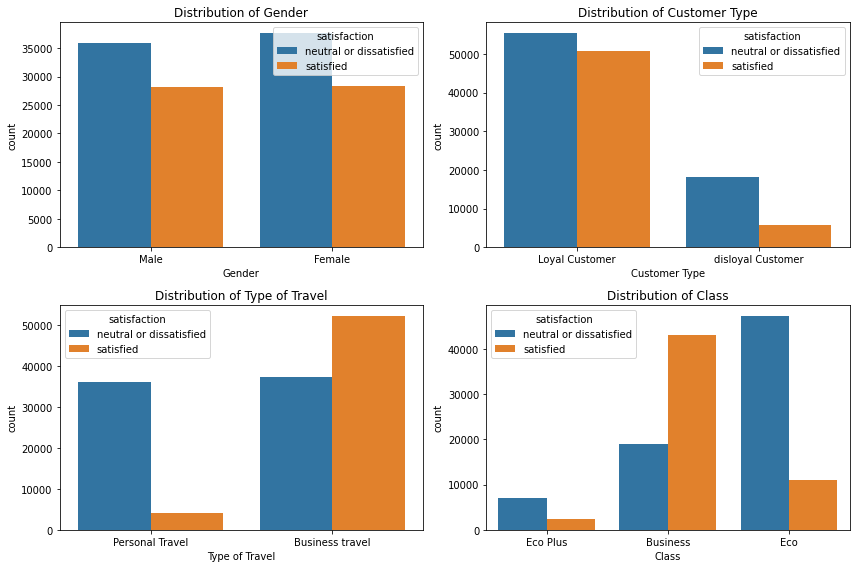

In [0]:
# Convert PySpark DataFrame to Pandas DataFrame for plotting
df_pd = df.toPandas()

# Plotting 
columns_to_plot = ['Gender', 'Customer Type', 'Type of Travel', 'Class']
fig, axes = plt.subplots(2, 2, figsize=(12, 8))
axes = axes.flatten()

for i, col in enumerate(columns_to_plot):
    sns.countplot(x=col, hue='satisfaction', data=df_pd, ax=axes[i])
    axes[i].set_title(f'Distribution of {col}')

plt.tight_layout()
plt.show()

In [0]:
# Count the number of items that exist in each class of satisfaction
normalized_counts = df.groupBy("satisfaction").count().withColumn("normalized_count", F.col("count") / df.count())
normalized_counts.show()

+--------------------+-----+-------------------+
|        satisfaction|count|   normalized_count|
+--------------------+-----+-------------------+
|neutral or dissat...|73452| 0.5655374191561441|
|           satisfied|56428|0.43446258084385586|
+--------------------+-----+-------------------+



In [0]:
# Index 'Gender', 'Customer Type', "Type of Travel", "Class", "satisfaction"
indexer = StringIndexer (inputCols = ['Gender', 'Customer Type', "Type of Travel", "Class", "satisfaction"], outputCols = ["Gender index",'Customer Type index', "Type of Travel index", "class index", "satisfaction index"])

indexed_df = indexer.fit(df).transform(df)

In [0]:
# Removing unnecessary columns
indexed_df = indexed_df.drop('Gender', 'Customer Type', "Type of Travel", "Class", "satisfaction")
display(indexed_df)

id,Age,Flight Distance,Inflight wifi service,Departure/Arrival time convenient,Ease of Online booking,Gate location,Food and drink,Online boarding,Seat comfort,Inflight entertainment,On-board service,Leg room service,Baggage handling,Checkin service,Inflight service,Cleanliness,Departure Delay in Minutes,Arrival Delay in Minutes,Gender index,Customer Type index,Type of Travel index,class index,satisfaction index
70172,13,460,3,4,3,1,5,3,5,5,4,3,4,4,5,5,25,18.0,1.0,0.0,1.0,2.0,0.0
5047,25,235,3,2,3,3,1,3,1,1,1,5,3,1,4,1,1,6.0,1.0,1.0,0.0,0.0,0.0
110028,26,1142,2,2,2,2,5,5,5,5,4,3,4,4,4,5,0,0.0,0.0,0.0,0.0,0.0,1.0
24026,25,562,2,5,5,5,2,2,2,2,2,5,3,1,4,2,11,9.0,0.0,0.0,0.0,0.0,0.0
119299,61,214,3,3,3,3,4,5,5,3,3,4,4,3,3,3,0,0.0,1.0,0.0,0.0,0.0,1.0
111157,26,1180,3,4,2,1,1,2,1,1,3,4,4,4,4,1,0,0.0,0.0,0.0,1.0,1.0,0.0
82113,47,1276,2,4,2,3,2,2,2,2,3,3,4,3,5,2,9,23.0,1.0,0.0,1.0,1.0,0.0
96462,52,2035,4,3,4,4,5,5,5,5,5,5,5,4,5,4,4,0.0,0.0,0.0,0.0,0.0,1.0
79485,41,853,1,2,2,2,4,3,3,1,1,2,1,4,1,2,0,0.0,0.0,0.0,0.0,0.0,0.0
65725,20,1061,3,3,3,4,2,3,3,2,2,3,4,4,3,2,0,0.0,1.0,1.0,0.0,1.0,0.0


In [0]:
# List all columns except 'ID'
columns_for_correlation = [col_name for col_name in indexed_df.columns if col_name != 'ID']

# Compute correlation between each column (except 'id') and 'satisfaction index'
correlations = {}
for column in columns_for_correlation:
    correlation = indexed_df.stat.corr(column, 'satisfaction index')
    correlations[column] = correlation

# Print correlations
for column, corr_value in correlations.items():
    print(f"Correlation between '{column}' and 'satisfaction index': {corr_value}")


Correlation between 'id' and 'satisfaction index': 0.013181954798104538
Correlation between 'Age' and 'satisfaction index': 0.13409123867754627
Correlation between 'Flight Distance' and 'satisfaction index': 0.2980848985459404
Correlation between 'Inflight wifi service' and 'satisfaction index': 0.28346023010121596
Correlation between 'Departure/Arrival time convenient' and 'satisfaction index': -0.05426971049373717
Correlation between 'Ease of Online booking' and 'satisfaction index': 0.16887713905283028
Correlation between 'Gate location' and 'satisfaction index': -0.002793274652471089
Correlation between 'Food and drink' and 'satisfaction index': 0.2113402076250674
Correlation between 'Online boarding' and 'satisfaction index': 0.5017494207376246
Correlation between 'Seat comfort' and 'satisfaction index': 0.34882934610259125
Correlation between 'Inflight entertainment' and 'satisfaction index': 0.39823365061187715
Correlation between 'On-board service' and 'satisfaction index': 0.3

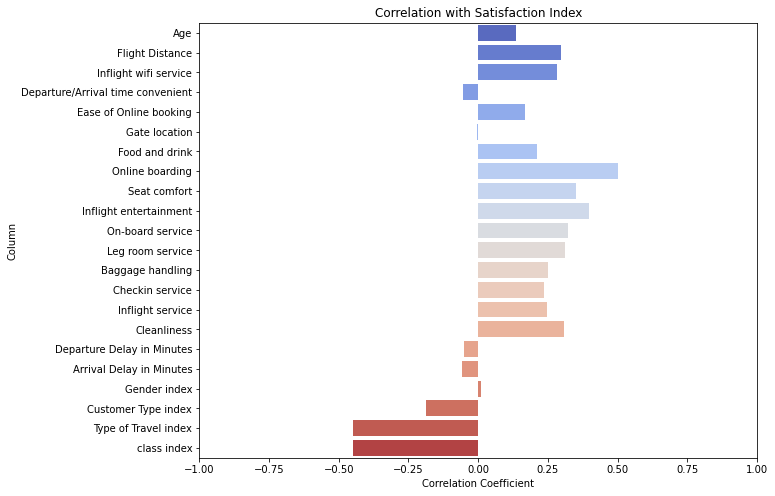

In [0]:
# List all column names except 'id' and 'satisfaction index'
columns_to_select = [col for col in indexed_df.columns if col != 'id' and col != 'satisfaction index']

# Select the columns from DataFrame
selected_data = indexed_df.select(columns_to_select + ['satisfaction index'])

# Calculate correlation coefficients for each column with 'satisfaction index'
correlations = []
for col in columns_to_select:
    correlation_value = selected_data.stat.corr(col, 'satisfaction index')
    correlations.append((col, correlation_value))

# Convert correlations to a Pandas DataFrame for plotting
correlation_df = pd.DataFrame(correlations, columns=['Column', 'Correlation'])

# Plot correlation values
plt.figure(figsize=(10, 8))
sns.barplot(x='Correlation', y='Column', data=correlation_df, palette='coolwarm')
plt.title('Correlation with Satisfaction Index')
plt.xlabel('Correlation Coefficient')
plt.ylabel('Column')
plt.xlim(-1, 1)
plt.show()


In [0]:
# Filter columns where absolute correlation > 0.25
columns_with_high_correlation = correlation_df[correlation_df['Correlation'].abs() > 0.25]['Column'].tolist()

print("Columns with correlation greater than 0.25 with 'satisfaction index':")
print(columns_with_high_correlation)

Columns with correlation greater than 0.25 with 'satisfaction index':
['Flight Distance', 'Inflight wifi service', 'Online boarding', 'Seat comfort', 'Inflight entertainment', 'On-board service', 'Leg room service', 'Cleanliness', 'Type of Travel index', 'class index']


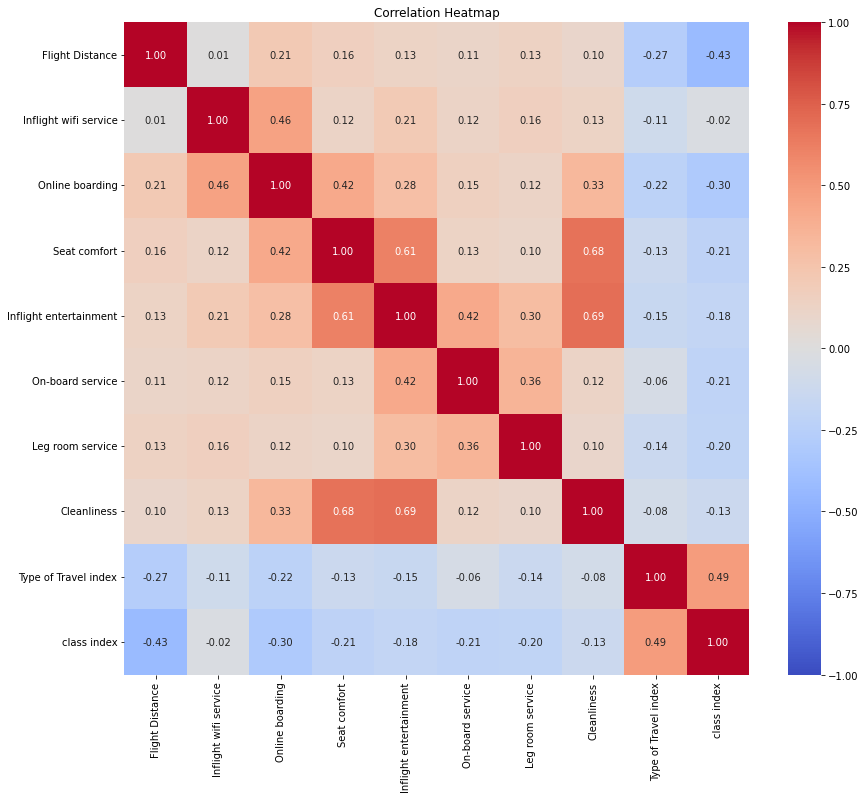

In [0]:
# Select the columns from DataFrame
selected_data = indexed_df.select(columns_with_high_correlation)

# Convert PySpark DataFrame to Pandas DataFrame for correlation computation
pandas_df = selected_data.toPandas()

# Calculate correlation matrix
correlation_matrix = pandas_df.corr()

# Plot heatmap using seaborn
plt.figure(figsize=(14, 12))
sns.heatmap(correlation_matrix, annot=True, cmap='coolwarm', fmt=".2f", vmin=-1, vmax=1, annot_kws={"size": 10})
plt.title('Correlation Heatmap')
plt.show()

In [0]:
featureassembler = VectorAssembler (inputCols = ['Flight Distance', 'Inflight wifi service', 'Online boarding', 'Seat comfort', 'Inflight entertainment', 'On-board service', 'Leg room service', 'Cleanliness', 'Type of Travel index', 'class index', 'satisfaction index'], outputCol = "Independent Features")
output = featureassembler.transform(indexed_df)

In [0]:
finalized_data = output.select("Independent Features", "satisfaction index")

In [0]:
display(finalized_data)

Independent Features,satisfaction index
"Map(vectorType -> dense, length -> 11, values -> List(460.0, 3.0, 3.0, 5.0, 5.0, 4.0, 3.0, 5.0, 1.0, 2.0, 0.0))",0.0
"Map(vectorType -> dense, length -> 11, values -> List(235.0, 3.0, 3.0, 1.0, 1.0, 1.0, 5.0, 1.0, 0.0, 0.0, 0.0))",0.0
"Map(vectorType -> dense, length -> 11, values -> List(1142.0, 2.0, 5.0, 5.0, 5.0, 4.0, 3.0, 5.0, 0.0, 0.0, 1.0))",1.0
"Map(vectorType -> dense, length -> 11, values -> List(562.0, 2.0, 2.0, 2.0, 2.0, 2.0, 5.0, 2.0, 0.0, 0.0, 0.0))",0.0
"Map(vectorType -> dense, length -> 11, values -> List(214.0, 3.0, 5.0, 5.0, 3.0, 3.0, 4.0, 3.0, 0.0, 0.0, 1.0))",1.0
"Map(vectorType -> dense, length -> 11, values -> List(1180.0, 3.0, 2.0, 1.0, 1.0, 3.0, 4.0, 1.0, 1.0, 1.0, 0.0))",0.0
"Map(vectorType -> dense, length -> 11, values -> List(1276.0, 2.0, 2.0, 2.0, 2.0, 3.0, 3.0, 2.0, 1.0, 1.0, 0.0))",0.0
"Map(vectorType -> dense, length -> 11, values -> List(2035.0, 4.0, 5.0, 5.0, 5.0, 5.0, 5.0, 4.0, 0.0, 0.0, 1.0))",1.0
"Map(vectorType -> dense, length -> 11, values -> List(853.0, 1.0, 3.0, 3.0, 1.0, 1.0, 2.0, 2.0, 0.0, 0.0, 0.0))",0.0
"Map(vectorType -> dense, length -> 11, values -> List(1061.0, 3.0, 3.0, 3.0, 2.0, 2.0, 3.0, 2.0, 0.0, 1.0, 0.0))",0.0


In [0]:
train_data , test_data = finalized_data.randomSplit([0.70,0.30])
rf = RandomForestClassifier(featuresCol = "Independent Features", labelCol = "satisfaction index")
rfModel = rf.fit(train_data)
predictions = rfModel.transform(test_data)

In [0]:
pred_results = rfModel.evaluate(test_data)
pred_results.predictions.show()

+--------------------+------------------+--------------------+--------------------+----------+
|Independent Features|satisfaction index|       rawPrediction|         probability|prediction|
+--------------------+------------------+--------------------+--------------------+----------+
|(11,[0,1,2,4,5,6]...|               0.0|[19.1321603927986...|[0.95660801963993...|       0.0|
|[31.0,5.0,5.0,4.0...|               1.0|[0.01010863005431...|[5.05431502715751...|       1.0|
|[56.0,3.0,3.0,1.0...|               0.0|[19.7859115375723...|[0.98929557687861...|       0.0|
|[67.0,1.0,1.0,3.0...|               0.0|[19.8979190378184...|[0.99489595189092...|       0.0|
|[67.0,2.0,2.0,4.0...|               0.0|[19.9546415831486...|[0.99773207915743...|       0.0|
|[67.0,3.0,3.0,2.0...|               0.0|[19.8979190378184...|[0.99489595189092...|       0.0|
|[67.0,3.0,3.0,2.0...|               0.0|[19.9249787177178...|[0.99624893588589...|       0.0|
|[67.0,3.0,3.0,5.0...|               0.0|[19.95464

In [0]:
evaluator = MulticlassClassificationEvaluator(labelCol="satisfaction index", predictionCol="prediction")
accuracy = evaluator.evaluate(predictions)
print("Accuracy = %s" % (accuracy))
print("Test Error = %s" % (1.0 - accuracy))

Accuracy = 1.0
Test Error = 0.0


In [0]:
from pyspark.mllib.evaluation import MulticlassMetrics
from pyspark.sql.types import FloatType
import pyspark.sql.functions as F

preds_and_labels = predictions.select(['prediction','satisfaction index']).withColumn('satisfaction index', F.col('satisfaction index').cast(FloatType())).orderBy('prediction')
preds_and_labels = preds_and_labels.select(['prediction','satisfaction index'])
metrics = MulticlassMetrics(preds_and_labels.rdd.map(tuple))
print(metrics.confusionMatrix().toArray())

/databricks/spark/python/pyspark/sql/context.py:165: FutureWarning: Deprecated in 3.0.0. Use SparkSession.builder.getOrCreate() instead.
  warnings.warn(


[[22005.     0.]
 [    0. 17161.]]


# Why I got 100% accuracy?!

In [0]:
display(train_data)

Independent Features,satisfaction index
"Map(vectorType -> sparse, length -> 11, indices -> List(0, 1, 2, 3, 5, 6), values -> List(2301.0, 3.0, 1.0, 3.0, 3.0, 2.0))",0.0
"Map(vectorType -> sparse, length -> 11, indices -> List(0, 1, 2, 3, 6, 7), values -> List(1600.0, 2.0, 4.0, 4.0, 1.0, 3.0))",0.0
"Map(vectorType -> sparse, length -> 11, indices -> List(0, 2, 3, 5, 6, 9), values -> List(569.0, 1.0, 4.0, 4.0, 5.0, 1.0))",0.0
"Map(vectorType -> sparse, length -> 11, indices -> List(0, 2, 3, 5, 6, 9), values -> List(612.0, 1.0, 4.0, 3.0, 5.0, 2.0))",0.0
"Map(vectorType -> dense, length -> 11, values -> List(31.0, 2.0, 4.0, 4.0, 5.0, 5.0, 2.0, 2.0, 1.0, 1.0, 0.0))",0.0
"Map(vectorType -> dense, length -> 11, values -> List(31.0, 4.0, 4.0, 1.0, 1.0, 1.0, 3.0, 1.0, 0.0, 1.0, 1.0))",1.0
"Map(vectorType -> dense, length -> 11, values -> List(56.0, 2.0, 5.0, 4.0, 2.0, 2.0, 2.0, 5.0, 0.0, 0.0, 1.0))",1.0
"Map(vectorType -> dense, length -> 11, values -> List(56.0, 4.0, 1.0, 2.0, 4.0, 4.0, 4.0, 2.0, 0.0, 0.0, 1.0))",1.0
"Map(vectorType -> dense, length -> 11, values -> List(67.0, 0.0, 0.0, 5.0, 5.0, 3.0, 4.0, 5.0, 0.0, 1.0, 1.0))",1.0
"Map(vectorType -> dense, length -> 11, values -> List(67.0, 0.0, 1.0, 1.0, 3.0, 2.0, 2.0, 3.0, 0.0, 0.0, 1.0))",1.0


Databricks visualization. Run in Databricks to view.

In [0]:
train_df.count()

Out[42]: 103904

In [0]:
test_data.count()

Out[43]: 39166

In [0]:
df.count()

Out[44]: 129880